# **EECS598-012: Unsupervised Visual Learning**

Before we start, please put your name and UMID in the following format

: Firstname LASTNAME, #00000000   //   e.g.) Andrew OWENS, #12345678

**Your Answer: Changyuan QIU, #28427971**   


#**Sound Source Localization**
In this notebook, we'll learn how to build and train an audio-visual model using self-supervised learning. Specifically, we'll let the network learn to localize sound sources by taking advantage of the correspondence between images and audio samples. 


The following papers might help you understand the model better. 

- [Relja Arandjelovi´ and Andrew Zisserman. Objects that Sound](https://arxiv.org/pdf/1712.06651.pdf)

We won't follow all the implementation details in the paper, yet the general idea is the same. 

The problem set is **due** on **Apr. 21**.

**Acknowledgement:** This Colab notebook is based on the assignment of CS294-158-SP20 given by Pieter Abbeel, Peter Chen, Jonathan Ho, and Aravind Srinivas，and EECS 498-007 / 598-005 given by Justin Johnson. 

We'll use Google Colab to do the homework. You'll write the code in the *.py files, and run the model in this notebook. Colab provides GPU resources, and it's also fine to use your local machine.

You'll be required to upload your notebook code and *.py code to Gradescope as a *.zip file.

## Setup Code

We'll need torchaudio package to process audio data. 

In [1]:
!pip install torchaudio --no-dependencies

Before getting started we need to run some boilerplate code to set up our environment. You'll need to rerun this setup code each time you start the notebook.

First, run this cell load the [autoreload](https://ipython.readthedocs.io/en/stable/config/extensions/autoreload.html?highlight=autoreload) extension. This allows us to edit `.py` source files, and re-import them into the notebook for a seamless editing and debugging experience.

In [2]:
%load_ext autoreload
%autoreload 2

### Google Colab Setup

- Check whether you have access to **GPU** resources on Colab. Go to **Runtime -> Change runtime type** and make sure you have selected **GPU** as the hardware accelerator. 
- Run the following cell to mount your Google Drive. Follow the link, sign in to your Google account (the same account you used to store this notebook!) and copy the authorization code into the text box that appears below.

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


Now recall the path in your Google Drive where you uploaded this notebook, fill it in below. If everything is working correctly then running the folowing cell should print the filenames from the assignment:

```
['av_loc.ipynb', 'models', '.ipynb_checkpoints', 'utils', 'pixel_cnn.ipynb', 'bigan.ipynb', 'vae.ipynb', 'dataset']
```

In [4]:
import os

# TODO: Fill in the Google Drive path where you uploaded the assignment
# Example: If you create a 2021WIN folder and put all the files under EECS598-012-ProblemSets folder, then '2021WIN/EECS598-012-ProblemSets'
GOOGLE_DRIVE_PATH_AFTER_MYDRIVE = '2021-Winter/EECS598-012-Unsupervised-CV/EECS598-012-ProblemSets'
GOOGLE_DRIVE_PATH = os.path.join('drive', 'My Drive', GOOGLE_DRIVE_PATH_AFTER_MYDRIVE)
print(os.listdir(GOOGLE_DRIVE_PATH))

['av_loc.ipynb', '.DS_Store', 'models', 'utils', 'dataset', 'pixel_cnn.ipynb', 'bigan.ipynb', 'vae.ipynb']


In [5]:
import sys
sys.path.append(GOOGLE_DRIVE_PATH)

In [ ]:
%cd /content/drive/MyDrive/2021-Winter/EECS598-012-Unsupervised-CV/EECS598-012-ProblemSets

/content/drive/.shortcut-targets-by-id/1RFc_2H3YtFAkx110lvOp6jcQMQlCB3Ct/2021-Winter/EECS598-012-Unsupervised-CV/EECS598-012-ProblemSets


In [6]:
import torch

import math
import matplotlib.pyplot as plt
%matplotlib inline

import utils
from models.av_loc_solver import train_av_loc

VoxCeleb2 dataset is a large-scale audio-visual speaker recognition dataset containing over 1.5k hours of videos for 6112 celebrities. We'll use a subset of VoxCeleb2, which includes around 7 hours of videos. 

We'll extract data from tiny_voxceleb.tar.gz file. Make sure you have downloaded the file and put it under the *dataset* folder. 

In [ ]:
%cd dataset
%pwd

/content/drive/.shortcut-targets-by-id/1RFc_2H3YtFAkx110lvOp6jcQMQlCB3Ct/2021-Winter/EECS598-012-Unsupervised-CV/EECS598-012-ProblemSets/dataset


'/content/drive/.shortcut-targets-by-id/1RFc_2H3YtFAkx110lvOp6jcQMQlCB3Ct/2021-Winter/EECS598-012-Unsupervised-CV/EECS598-012-ProblemSets/dataset'

In [ ]:
!tar -zxvf "/content/drive/MyDrive/2021-Winter/EECS598-012-Unsupervised-CV/dataset/tiny_voxceleb.tar.gz"

Streaming output truncated to the last 5000 lines.
tiny_voxceleb/lG5H9PKTfxc_82.480_87.580/frames/frame000043.jpg
tiny_voxceleb/lG5H9PKTfxc_82.480_87.580/frames/frame000027.jpg
tiny_voxceleb/lG5H9PKTfxc_82.480_87.580/frames/frame000033.jpg
tiny_voxceleb/lG5H9PKTfxc_82.480_87.580/frames/frame000023.jpg
tiny_voxceleb/lG5H9PKTfxc_82.480_87.580/frames/frame000024.jpg
tiny_voxceleb/lG5H9PKTfxc_82.480_87.580/frames/frame000040.jpg
tiny_voxceleb/lG5H9PKTfxc_82.480_87.580/frames/frame000015.jpg
tiny_voxceleb/lG5H9PKTfxc_82.480_87.580/frames/frame000005.jpg
tiny_voxceleb/lG5H9PKTfxc_82.480_87.580/frames/frame000042.jpg
tiny_voxceleb/lG5H9PKTfxc_82.480_87.580/frames/frame000041.jpg
tiny_voxceleb/lG5H9PKTfxc_82.480_87.580/frames/frame000022.jpg
tiny_voxceleb/lG5H9PKTfxc_82.480_87.580/frames/frame000038.jpg
tiny_voxceleb/lG5H9PKTfxc_82.480_87.580/frames/frame000007.jpg
tiny_voxceleb/lG5H9PKTfxc_82.480_87.580/frames/frame000013.jpg
tiny_voxceleb/lG5H9PKTfxc_82.480_87.580/frames/frame000039.jpg
tiny

Run the cell below to visualize some image samples from the VoxCeleb2 dataset. 

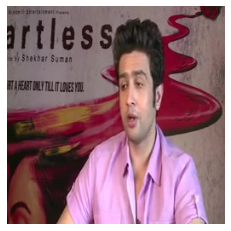

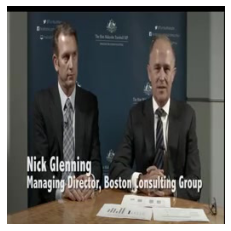

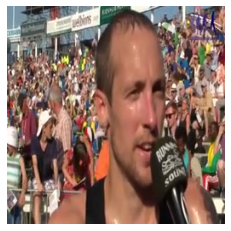

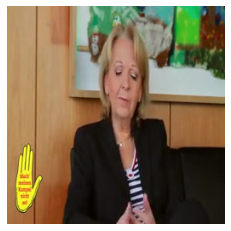

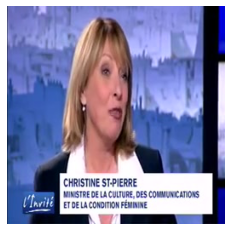

In [7]:
# Visualize some images
from PIL import Image
import matplotlib.pyplot as plt
dset_path = "tiny_voxceleb"
vide_ids = os.listdir(dset_path)[:5]
for i in range(5): 
    frame_name = os.listdir(os.path.join(dset_path, vide_ids[i], 'frames'))[0]
    image = Image.open(os.path.join(dset_path, vide_ids[i], 'frames', frame_name))
    plt.figure()
    plt.axis('off')
    plt.imshow(image)


##Objects that sound

In this part, we'll train an audio-visual learning model. 

We'll use the VoxCeleb2 dataset to train the audio-visual learning model. We denote the $i$-th audio-visual paired sample as $\mathbf{x}^i$ and $\mathbf{s}^i$. During training, we'll have an image encoder $f$ and an audio encoder $g$ to extract visual features and audio features, respectively. 

We use a residual network to extract a 16x16x128 feature map. We use $f(\mathbf{x}_i^j) \in \mathbb{R}^{128}$ to denote the feature vector for $i$-th ($i \in \{1, ..., 256\}$) image region  in image $\mathbf{x}^j$, And we'll use a VGG-style network to extract 128-dimensional features for the audio $g(\mathbf{s}^j)$. $f(\mathbf{x}_i^j)$ and $g(\mathbf{s}^j)$ are $l$-2 normalized features. Both of the networks are implemented in **models/av_loc_model.py**. 

Following the work of [Relja Arandjelovi´ and Andrew Zisserman](https://arxiv.org/pdf/1712.06651.pdf), we can learn our model by using the correspondence of image and audio samples. Namely, given $N-1$ other random negative audio, $f(\mathbf{x}^j)$ should have a high dot product with its corresponding audio $g(\mathbf{s}^j)$, and a low dot product with every other audio example. Different from the paper, we can use contrastive learning to achieve this. For an image $x^i$, we can construct negative pairs using $N-1$ negative audio. 

We'll have two phases in training. During the first half of training epochs, the similarity between $\mathbf{x}^j$ and $\mathbf{s}^j$ is computed by averaging over all image regions. 

$$\mathcal{L}_1^i = -\log{\frac{\exp(\frac{1}{256} \sum_{k=1}^{256}{f(\mathbf{x}_k^i)^{\top}g(\mathbf{s}^i)/\tau})}{\sum_{j=1}^{N}\exp(\frac{1}{256}\sum_{k=1}^{256}{f(\mathbf{x}_k^i)^{\top}g(\mathbf{s}^j)/\tau})}}$$

, where $\tau$ is set to 0.1. During the second half of training, the similarity between $\mathbf{x}^j$ and $\mathbf{s}^j$ is computed by taking the maximum over all image regions (similar to the global max pooling operation in the paper). 

$$\mathcal{L}_2^i = -\log{\frac{\exp(\max_{k}\{{f(\mathbf{x}_k^i)^{\top}g(\mathbf{s}^i)/\tau}\})}{\sum_{j=1}^{N}\exp(\max_{k}\{{f(\mathbf{x}_k^j)^{\top}g(\mathbf{s}^i)/\tau}\})}}$$

We provide a training code template in **models/av_loc_solver.py** and a model in **models/av_loc_model.py**. Please follow the instructions and implement the loss for training the audio-visual model. 

We provide the functions for plotting and visualizing images. **You'll provide the following results.**
- Record the loss of the training data (per mini-batch) and testing data (per epoch).
- Show 100 sound source localization results. 

The training will take around 60 minutes. 

In [8]:
from utils.data import ImgAudDset
 
exp_path = 'samples'
if not os.path.exists(exp_path): 
  os.makedirs(exp_path)
list_train = 'tiny_voxceleb/train.csv'
list_test = 'tiny_voxceleb/test.csv'
train_dataset = ImgAudDset(list_train, split='train')
test_dataset = ImgAudDset(list_test, split='test')

# sample of train: 5000
# sample of test: 100


In [ ]:
%pwd

'/content/drive/.shortcut-targets-by-id/1RFc_2H3YtFAkx110lvOp6jcQMQlCB3Ct/2021-Winter/EECS598-012-Unsupervised-CV/EECS598-012-ProblemSets/dataset'

Epoch 0 loss: 4.8101: 100%|█████████▉| 4992/5000 [01:03<00:00, 79.03it/s]


4.6003
Epoch 0, Test loss 4.6003


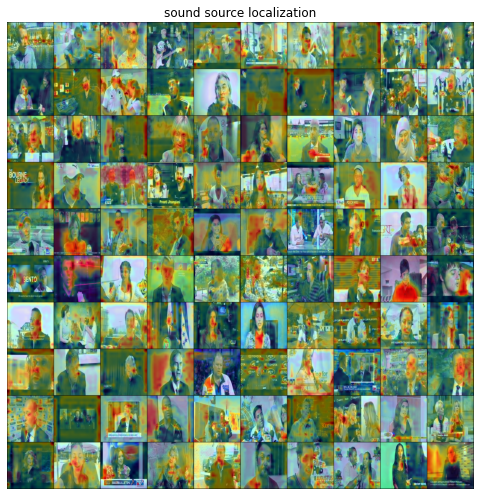

Epoch 1 loss: 4.8405: 100%|█████████▉| 4992/5000 [01:00<00:00, 82.16it/s]


4.6243
Epoch 1, Test loss 4.6243


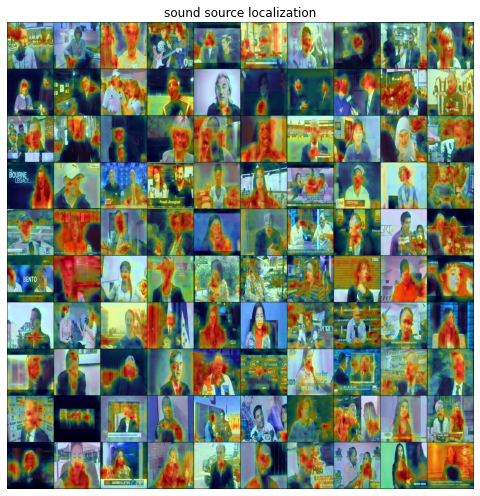

Epoch 2 loss: 4.7868: 100%|█████████▉| 4992/5000 [01:00<00:00, 82.12it/s]


4.6049
Epoch 2, Test loss 4.6049


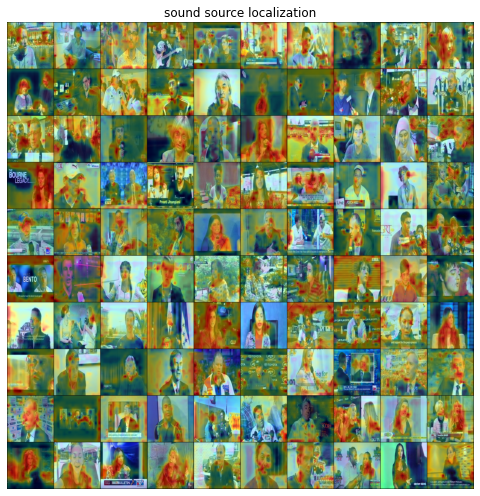

Epoch 3 loss: 4.7732: 100%|█████████▉| 4992/5000 [01:01<00:00, 81.79it/s]


4.5634
Epoch 3, Test loss 4.5634


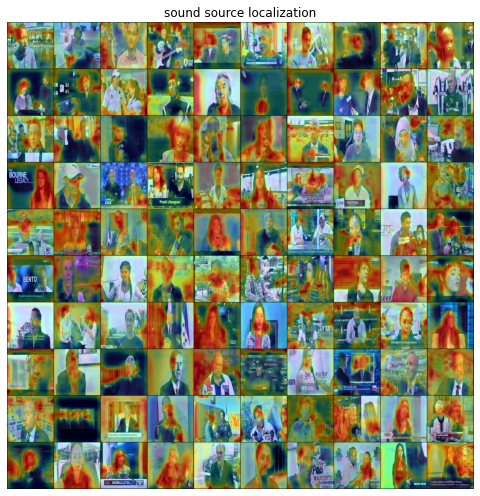

Epoch 4 loss: 4.8603: 100%|█████████▉| 4992/5000 [00:59<00:00, 83.29it/s]


4.5438
Epoch 4, Test loss 4.5438


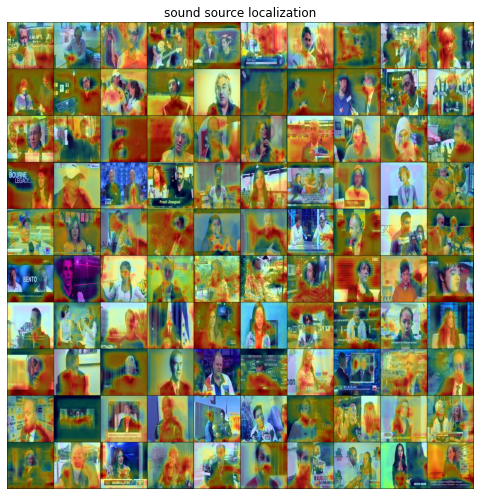

Epoch 5 loss: 4.6791: 100%|█████████▉| 4992/5000 [01:02<00:00, 79.91it/s]


4.5272
Epoch 5, Test loss 4.5272


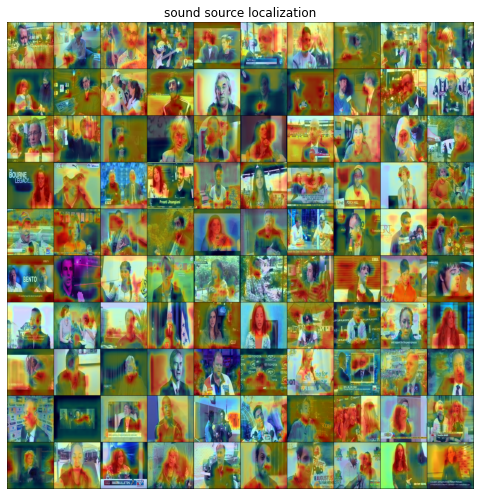

Epoch 6 loss: 4.6800: 100%|█████████▉| 4992/5000 [01:01<00:00, 81.46it/s]


4.4837
Epoch 6, Test loss 4.4837


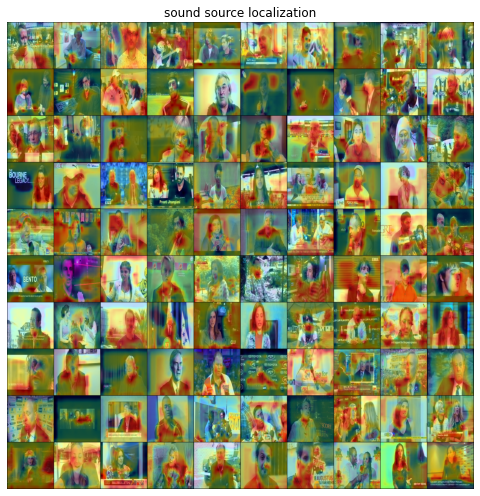

Epoch 7 loss: 4.6426: 100%|█████████▉| 4992/5000 [01:01<00:00, 81.06it/s]


4.6450
Epoch 7, Test loss 4.6450


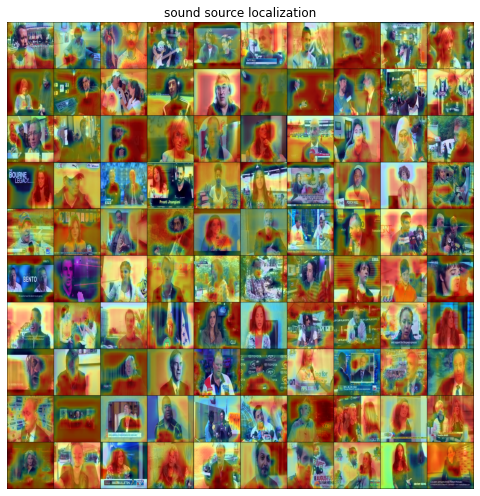

Epoch 8 loss: 4.5997: 100%|█████████▉| 4992/5000 [01:00<00:00, 82.10it/s]


4.5165
Epoch 8, Test loss 4.5165


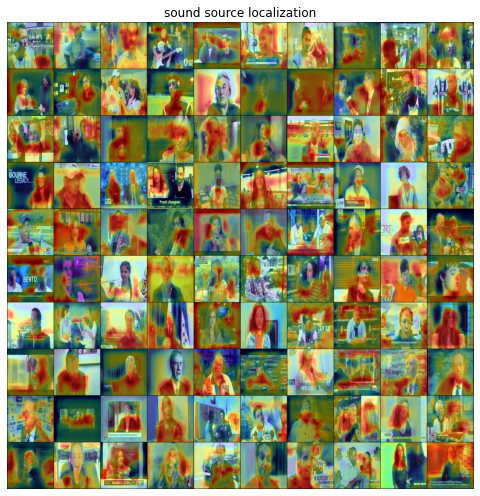

Epoch 9 loss: 4.5966: 100%|█████████▉| 4992/5000 [01:01<00:00, 81.13it/s]


4.4916
Epoch 9, Test loss 4.4916


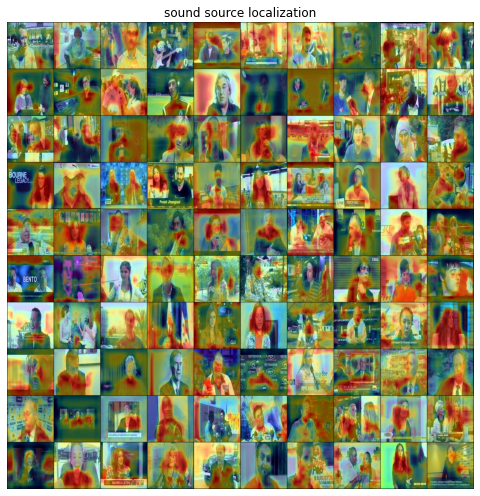

Epoch 10 loss: 4.6219: 100%|█████████▉| 4992/5000 [01:01<00:00, 81.23it/s]


4.5704
Epoch 10, Test loss 4.5704


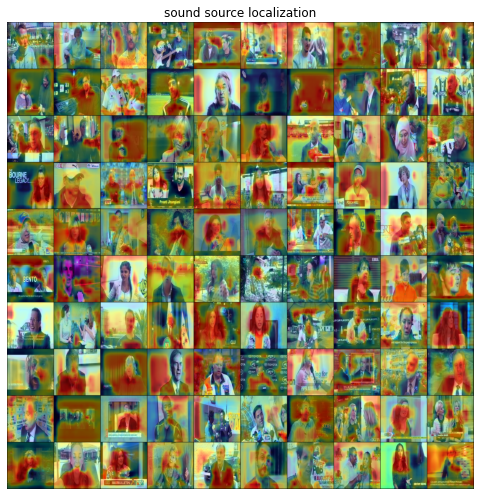

Epoch 11 loss: 4.5215: 100%|█████████▉| 4992/5000 [01:01<00:00, 81.03it/s]


4.6143
Epoch 11, Test loss 4.6143


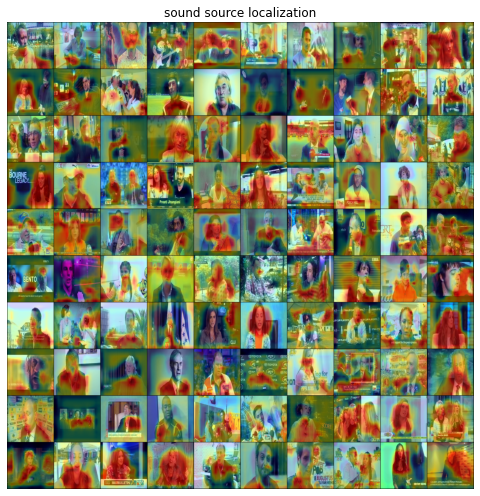

Epoch 12 loss: 4.5231: 100%|█████████▉| 4992/5000 [01:02<00:00, 79.82it/s]


4.6780
Epoch 12, Test loss 4.6780


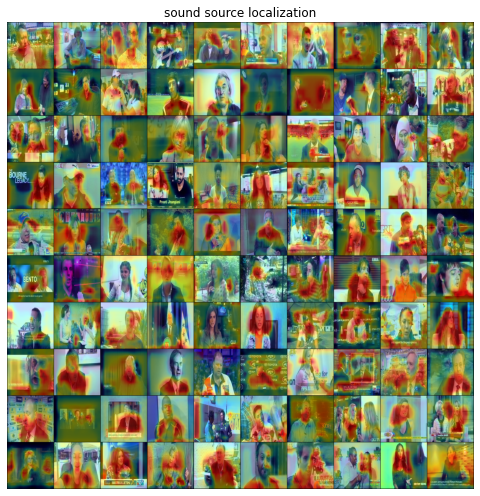

Epoch 13 loss: 4.5513: 100%|█████████▉| 4992/5000 [01:02<00:00, 80.32it/s]


4.6152
Epoch 13, Test loss 4.6152


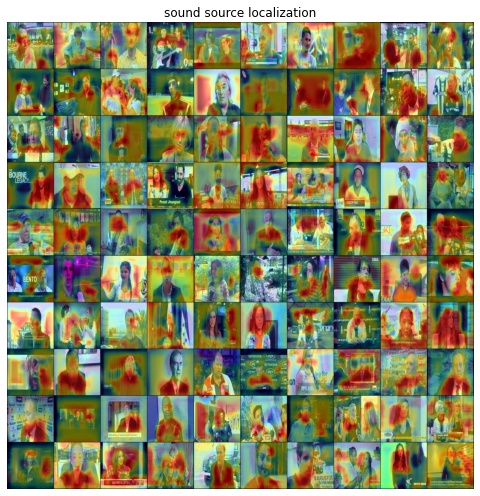

Epoch 14 loss: 4.4577: 100%|█████████▉| 4992/5000 [01:02<00:00, 80.44it/s]


4.6050
Epoch 14, Test loss 4.6050


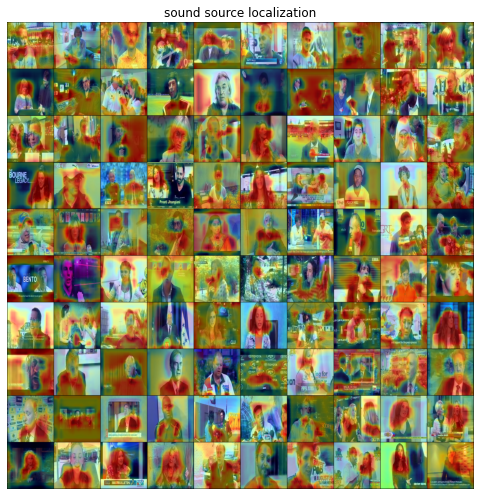

Epoch 15 loss: 4.4550: 100%|█████████▉| 4992/5000 [01:01<00:00, 81.63it/s]


5.0712
Epoch 15, Test loss 5.0712


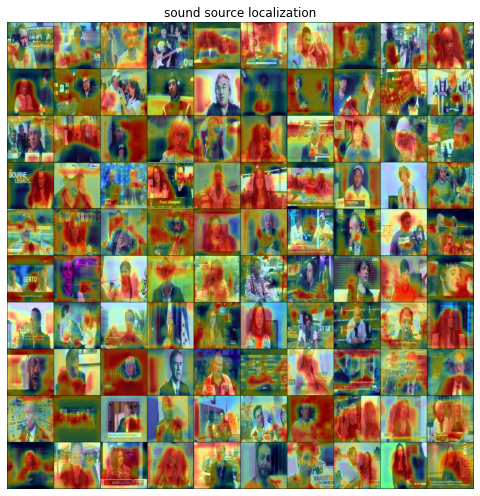

Epoch 16 loss: 4.4957: 100%|█████████▉| 4992/5000 [01:01<00:00, 81.52it/s]


4.5664
Epoch 16, Test loss 4.5664


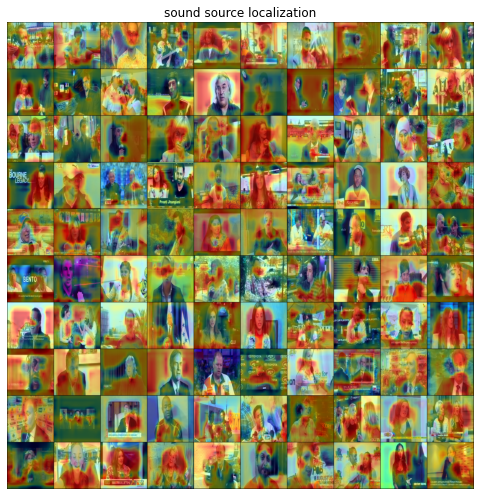

Epoch 17 loss: 4.3236: 100%|█████████▉| 4992/5000 [01:01<00:00, 81.45it/s]


4.4529
Epoch 17, Test loss 4.4529


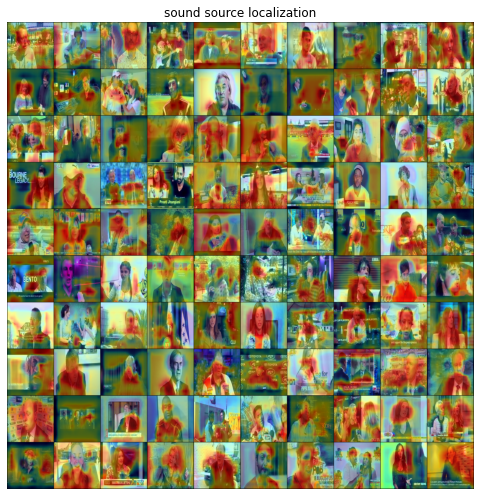

Epoch 18 loss: 4.3816: 100%|█████████▉| 4992/5000 [01:01<00:00, 81.39it/s]


4.6345
Epoch 18, Test loss 4.6345


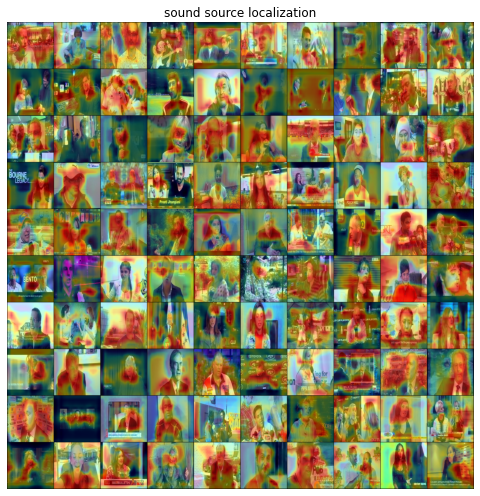

Epoch 19 loss: 4.3942: 100%|█████████▉| 4992/5000 [01:01<00:00, 81.55it/s]


4.8475
Epoch 19, Test loss 4.8475


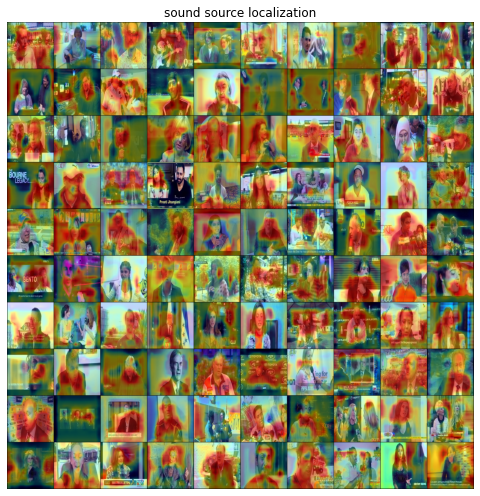

Epoch 20 loss: 4.3172: 100%|█████████▉| 4992/5000 [01:01<00:00, 80.59it/s]


4.9097
Epoch 20, Test loss 4.9097


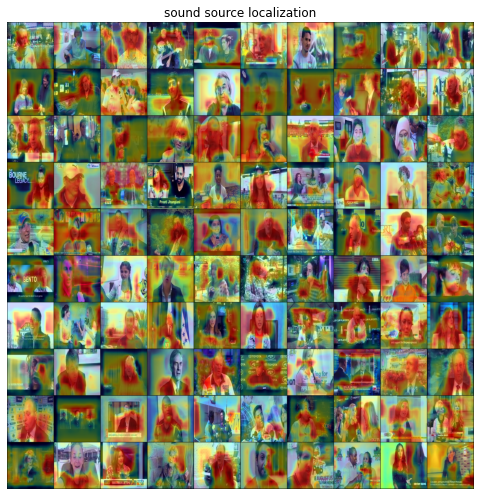

Epoch 21 loss: 4.2865: 100%|█████████▉| 4992/5000 [01:02<00:00, 80.22it/s]


4.6306
Epoch 21, Test loss 4.6306


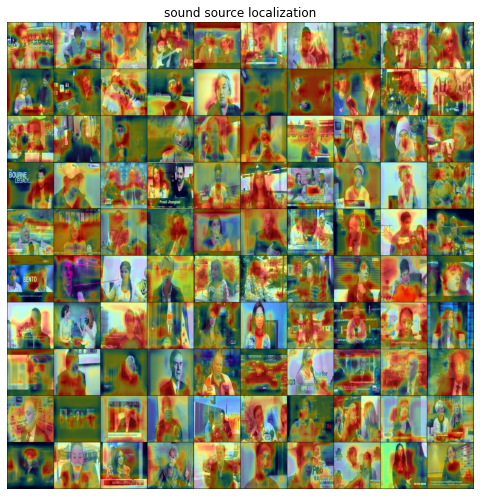

Epoch 22 loss: 4.2508: 100%|█████████▉| 4992/5000 [01:04<00:00, 77.41it/s]


4.6016
Epoch 22, Test loss 4.6016


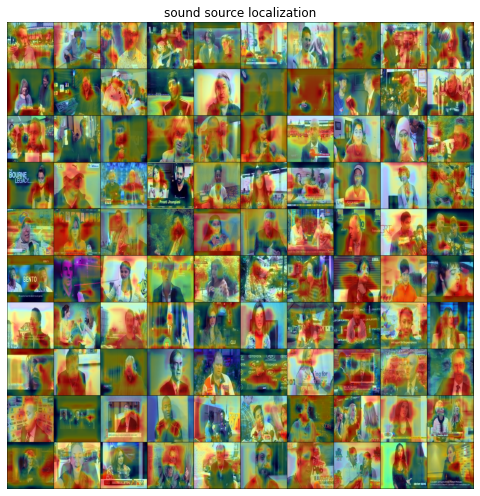

Epoch 23 loss: 4.1601: 100%|█████████▉| 4992/5000 [01:01<00:00, 80.78it/s]


4.5029
Epoch 23, Test loss 4.5029


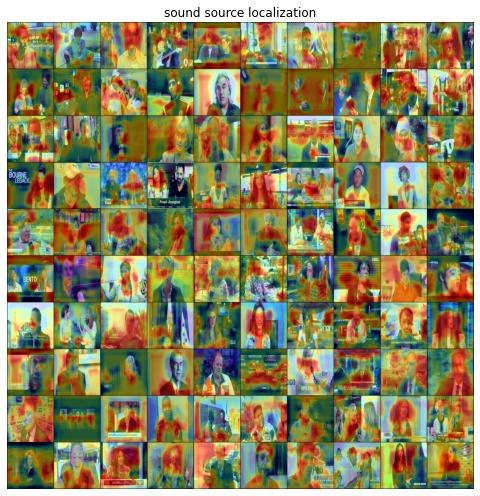

Epoch 24 loss: 4.2829: 100%|█████████▉| 4992/5000 [01:04<00:00, 77.97it/s]


5.2315
Epoch 24, Test loss 5.2315


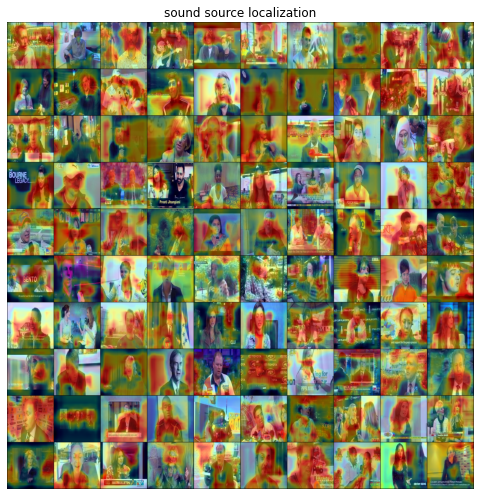

Epoch 25 loss: 4.7803: 100%|█████████▉| 4992/5000 [01:02<00:00, 79.60it/s]


4.5423
Epoch 25, Test loss 4.5423


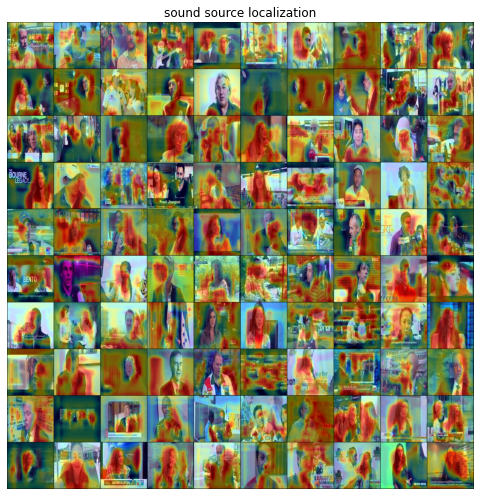

Epoch 26 loss: 4.6433: 100%|█████████▉| 4992/5000 [01:02<00:00, 79.42it/s]


4.5840
Epoch 26, Test loss 4.5840


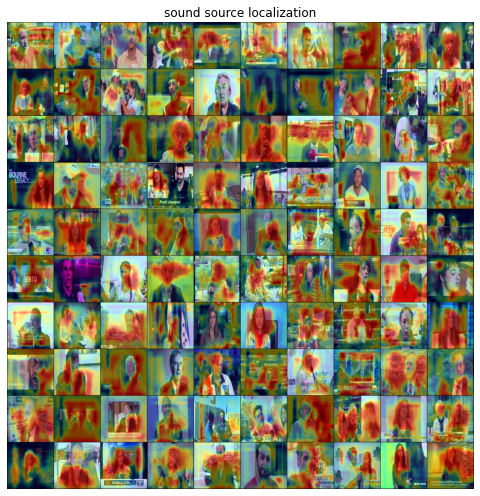

Epoch 27 loss: 4.5840: 100%|█████████▉| 4992/5000 [01:03<00:00, 78.92it/s]


4.5391
Epoch 27, Test loss 4.5391


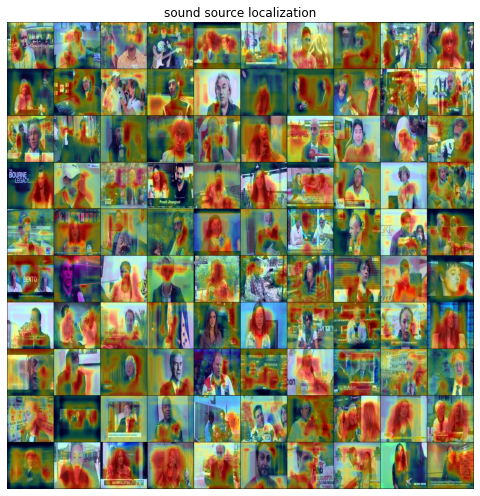

Epoch 28 loss: 4.6439: 100%|█████████▉| 4992/5000 [01:02<00:00, 79.92it/s]


4.6189
Epoch 28, Test loss 4.6189


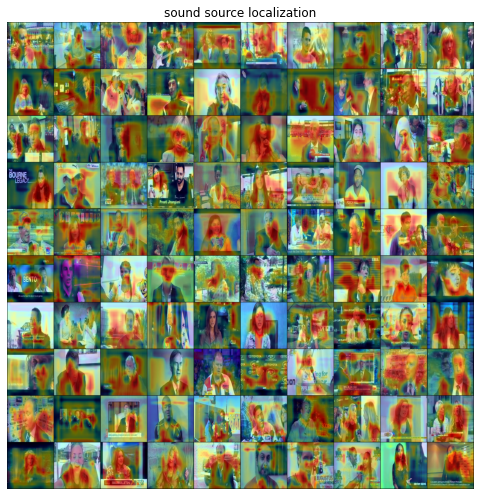

Epoch 29 loss: 4.4717: 100%|█████████▉| 4992/5000 [01:02<00:00, 79.78it/s]


4.6536
Epoch 29, Test loss 4.6536


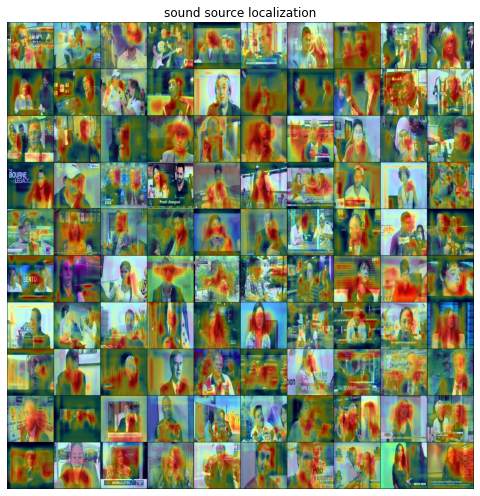

Epoch 30 loss: 4.5659: 100%|█████████▉| 4992/5000 [01:03<00:00, 78.27it/s]


4.6531
Epoch 30, Test loss 4.6531


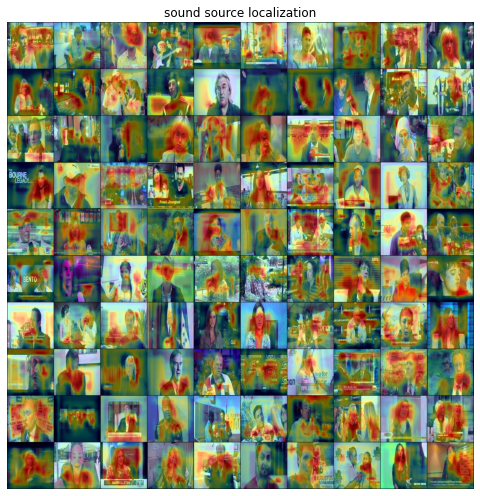

Epoch 31 loss: 4.4177: 100%|█████████▉| 4992/5000 [01:02<00:00, 79.69it/s]


4.5901
Epoch 31, Test loss 4.5901


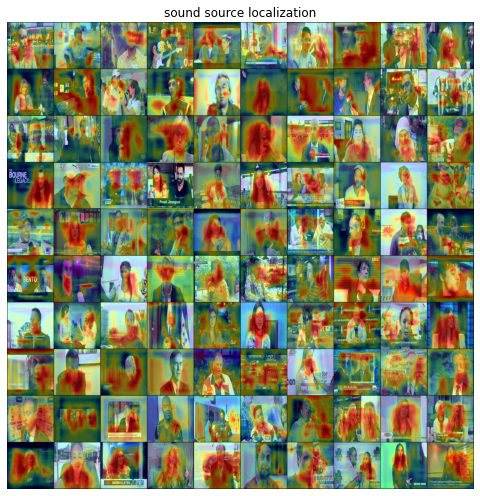

Epoch 32 loss: 4.6144: 100%|█████████▉| 4992/5000 [01:03<00:00, 78.91it/s]


4.5749
Epoch 32, Test loss 4.5749


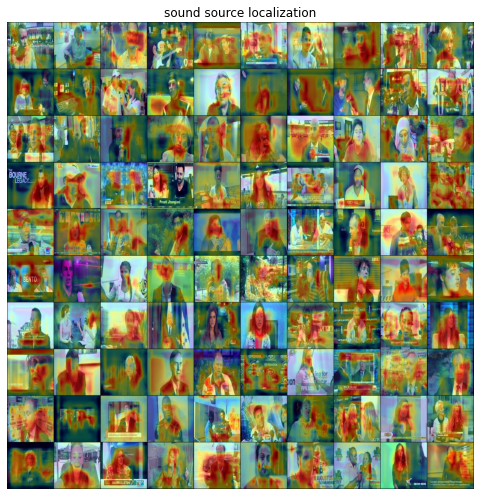

Epoch 33 loss: 4.4254: 100%|█████████▉| 4992/5000 [01:03<00:00, 78.45it/s]


4.5844
Epoch 33, Test loss 4.5844


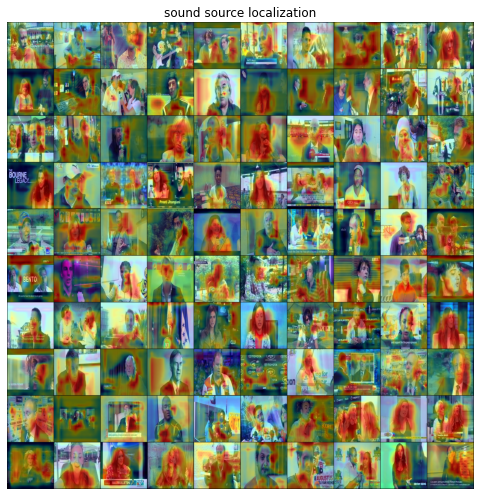

Epoch 34 loss: 4.5210: 100%|█████████▉| 4992/5000 [01:04<00:00, 77.61it/s]


4.5106
Epoch 34, Test loss 4.5106


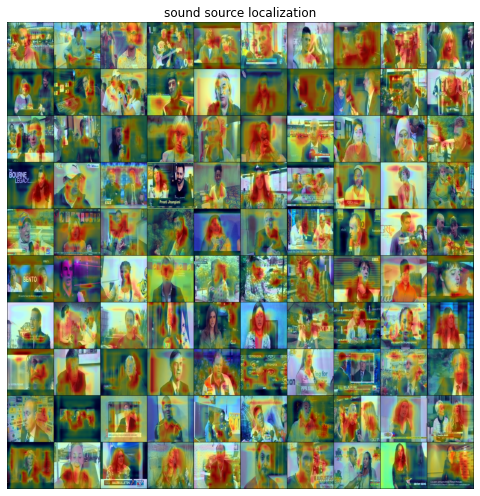

Epoch 35 loss: 4.4167: 100%|█████████▉| 4992/5000 [01:04<00:00, 77.87it/s]


4.5776
Epoch 35, Test loss 4.5776


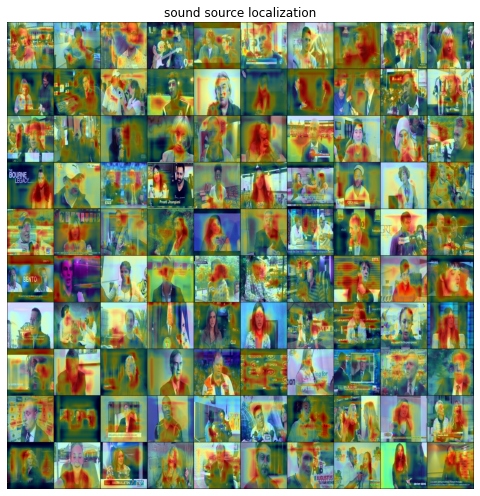

Epoch 36 loss: 4.4396: 100%|█████████▉| 4992/5000 [01:05<00:00, 76.40it/s]


4.5717
Epoch 36, Test loss 4.5717


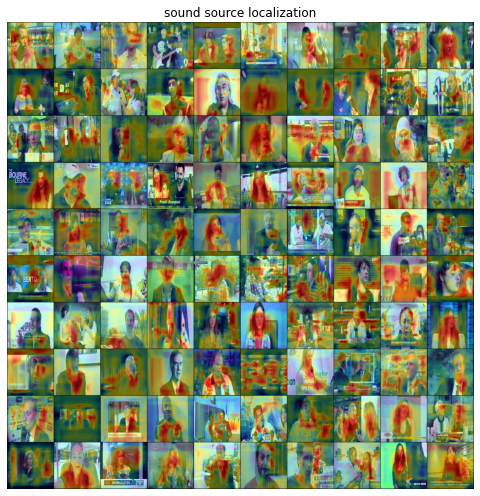

Epoch 37 loss: 4.3985: 100%|█████████▉| 4992/5000 [01:03<00:00, 78.16it/s]


4.4841
Epoch 37, Test loss 4.4841


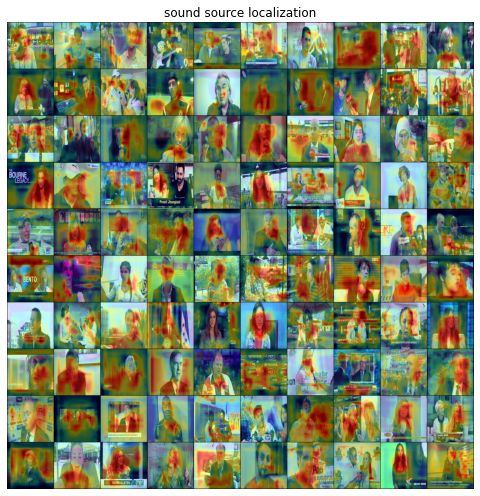

Epoch 38 loss: 4.3085: 100%|█████████▉| 4992/5000 [01:04<00:00, 77.71it/s]


4.4317
Epoch 38, Test loss 4.4317


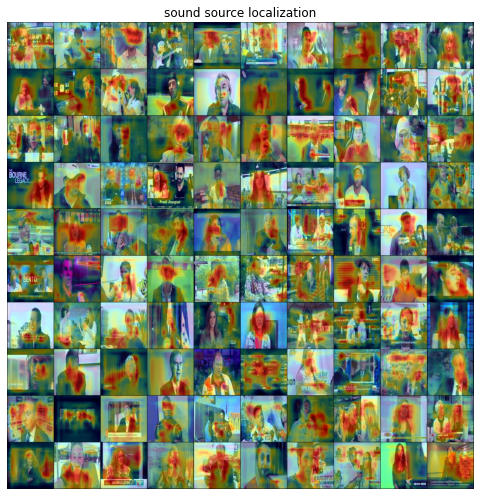

Epoch 39 loss: 4.2167: 100%|█████████▉| 4992/5000 [01:03<00:00, 78.18it/s]


4.5384
Epoch 39, Test loss 4.5384


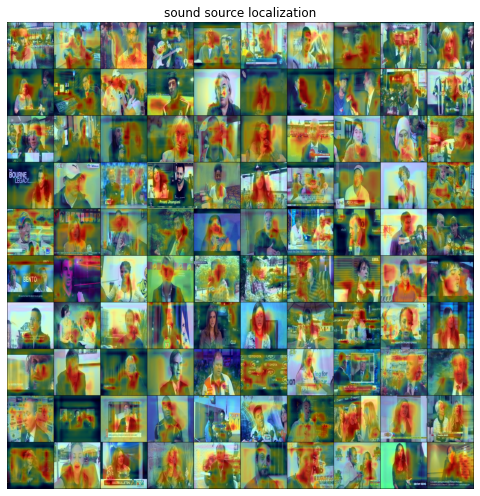

Epoch 40 loss: 4.3746: 100%|█████████▉| 4992/5000 [01:04<00:00, 77.74it/s]


4.5495
Epoch 40, Test loss 4.5495


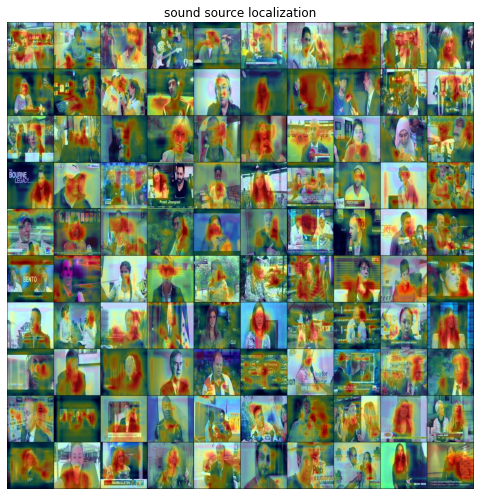

Epoch 41 loss: 4.2069: 100%|█████████▉| 4992/5000 [01:05<00:00, 75.69it/s]


4.5037
Epoch 41, Test loss 4.5037


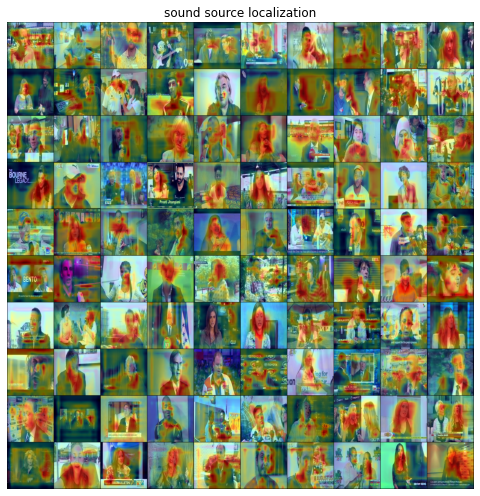

Epoch 42 loss: 4.3539: 100%|█████████▉| 4992/5000 [01:06<00:00, 75.15it/s]


4.5650
Epoch 42, Test loss 4.5650


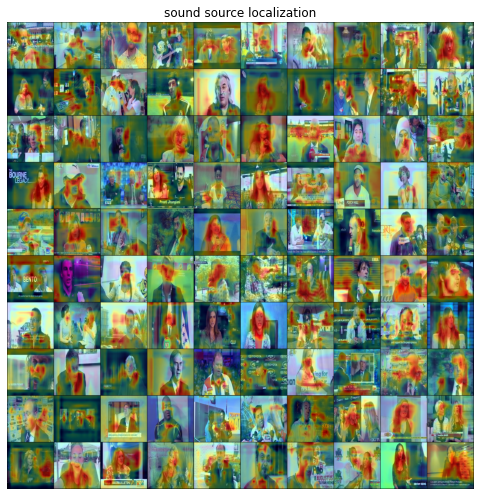

Epoch 43 loss: 4.1252: 100%|█████████▉| 4992/5000 [01:06<00:00, 75.62it/s]


4.5987
Epoch 43, Test loss 4.5987


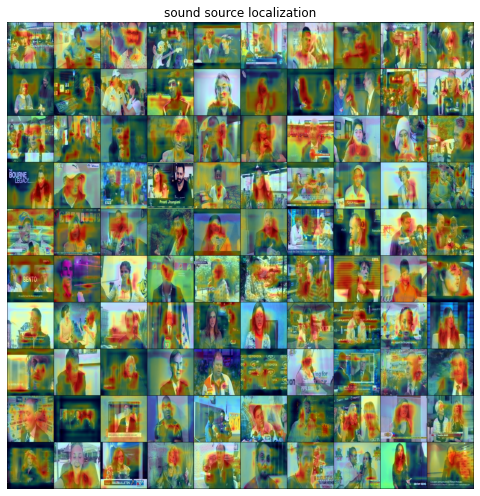

Epoch 44 loss: 4.2072: 100%|█████████▉| 4992/5000 [01:06<00:00, 74.54it/s]


4.4631
Epoch 44, Test loss 4.4631


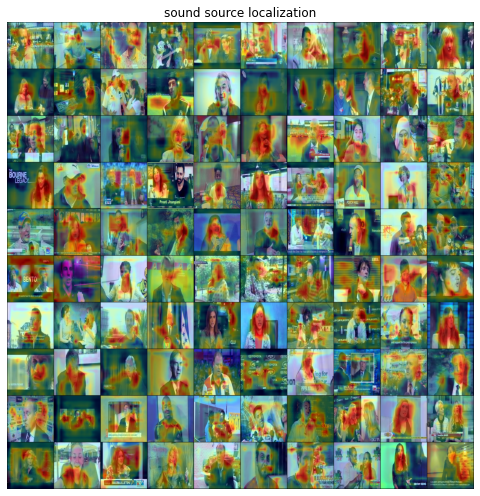

Epoch 45 loss: 4.1872: 100%|█████████▉| 4992/5000 [01:05<00:00, 75.86it/s]


4.4959
Epoch 45, Test loss 4.4959


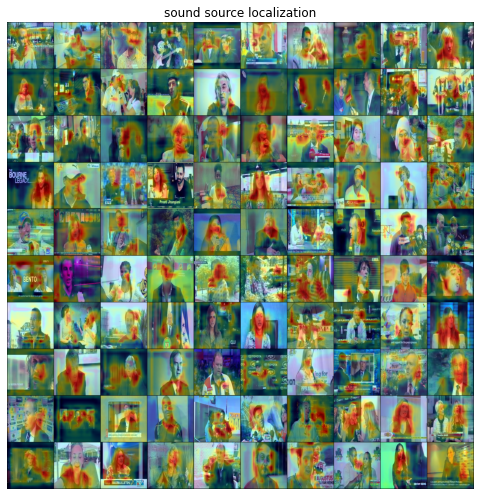

Epoch 46 loss: 4.1792: 100%|█████████▉| 4992/5000 [01:05<00:00, 76.23it/s]


4.6000
Epoch 46, Test loss 4.6000


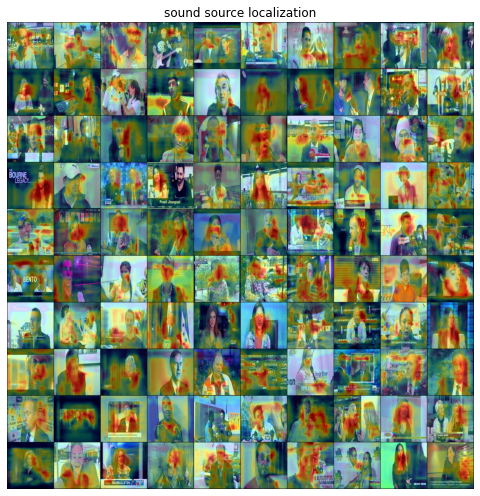

Epoch 47 loss: 4.2327: 100%|█████████▉| 4992/5000 [01:05<00:00, 76.13it/s]


4.5724
Epoch 47, Test loss 4.5724


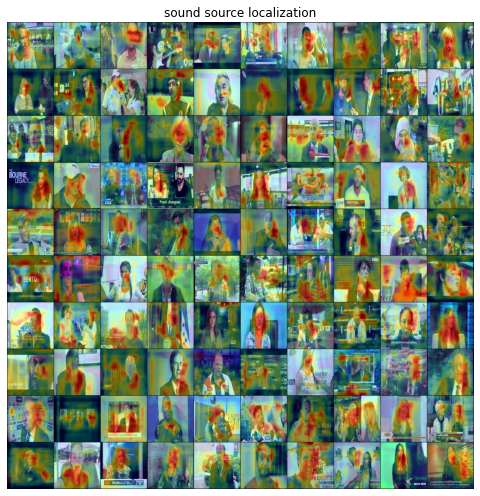

Epoch 48 loss: 4.0641: 100%|█████████▉| 4992/5000 [01:04<00:00, 76.83it/s]


4.7046
Epoch 48, Test loss 4.7046


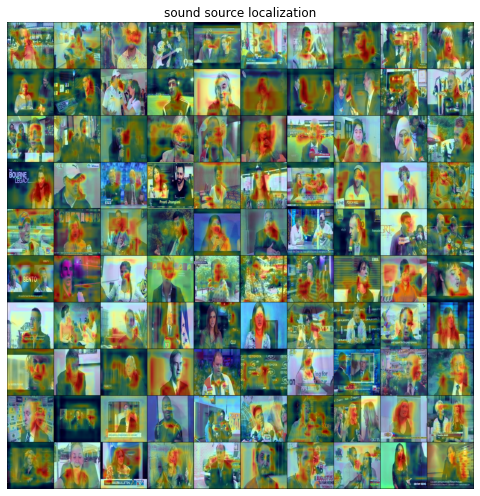

Epoch 49 loss: 4.0970: 100%|█████████▉| 4992/5000 [01:05<00:00, 76.35it/s]


4.5679
Epoch 49, Test loss 4.5679


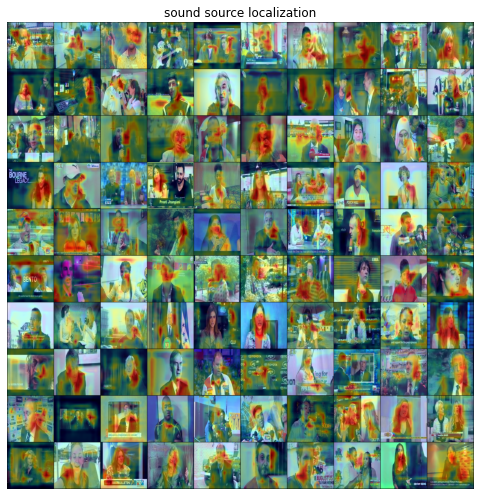

In [9]:
train_losses, test_losses, ssl_imgs = train_av_loc(train_dataset, test_dataset, exp_path=exp_path, quiet=False)

(100, 3, 256, 256)


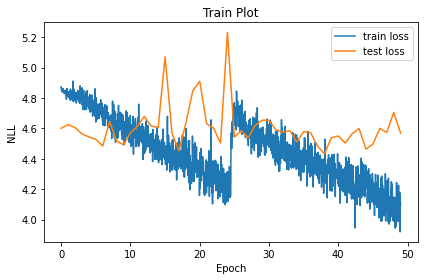

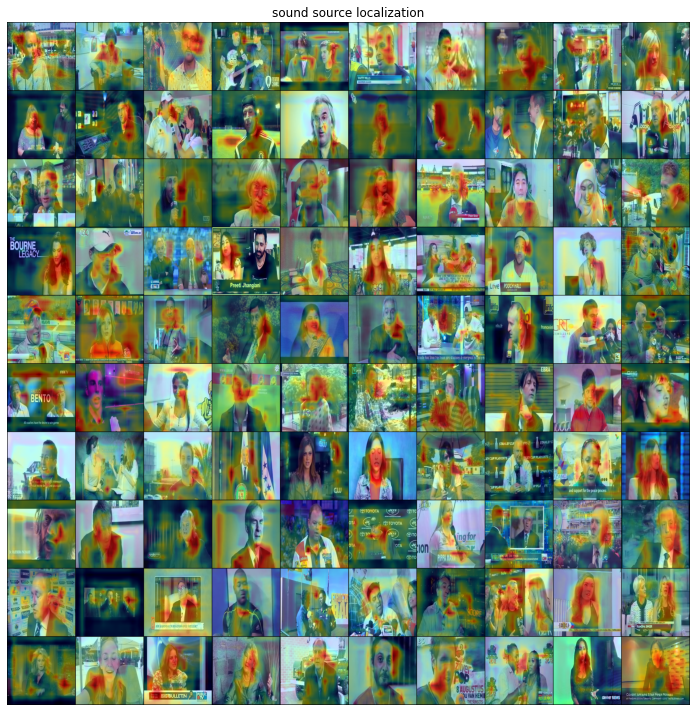

In [10]:
from utils.vis import show_samples, save_training_plot
print(ssl_imgs.shape)
save_training_plot(train_losses, test_losses, 'Train Plot',
                    'results/av_loc_train_plot.png')
ssl_imgs = ssl_imgs[:100]
show_samples(ssl_imgs, fname='results/av_loc_samples.png', title='sound source localization', nrow=10, figsize=(10,10))

In [ ]:
from tqdm import tqdm
tqdm._instances.clear()